# Neural Structured Learning on Time Series - Fictitious dataset

Two novelties are implemented in this notebook:
* Use the GraphNet framework for implementing algorithms with inductive biases for time-series
* Use implicit reparametrization gradients to learn with SGD the parameters of a gamma distribution instead of an empirical error on the output. This is closer to reality and should work better.


## Load data:

In [1]:
from collections import OrderedDict
import os

from tqdm import tqdm

import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
from tensorflow.keras.layers import Input, Dense, Conv1D, GlobalAveragePooling1D, Dropout
from tensorflow.keras import Sequential,Model
from tensorflow_probability import distributions

import tensorflow.keras as keras

from utils import get_indices, data_from_experiment, get_graph_data, get_graph_data_multiple_experiments, get_multi_batch

tf.keras.backend.set_floatx('float64')
config = ConfigProto()
config.gpu_options.allow_growth = True
sess = InteractiveSession(config=config)

import numpy as np
import matplotlib.pyplot as pplot
tfd = tfp.distributions
from ipywidgets import FloatSlider, IntSlider, interact, interactive
from datasets.femto_bearing import FEMTOBearingsDataset

import pandas as pd

from minigraphnets import Edge,Node, Graph
from graphnet_utils import GraphNet, GraphNetFunctionFactory

#from datasets.femto_bearing import FEMTOBearingsDataset


not running in colab.


In [2]:

data_root= '/mnt/6c99ccdb-4d5e-443d-b361-8b5137623ef6/'
rootfolder_pickles='%s/Dataset/bearing_fatigue_dataset/'%data_root
npz_file='%s/Dataset/bearing_fatigue_dataset/first_stage_preproc_bearings_v2.npz'%data_root
femto_dataset = FEMTOBearingsDataset(rootfolder_pickles=rootfolder_pickles, npz_file=npz_file)

training set:
00 1 1_1 2803
03 1 1_4 1428
04 1 1_5 2463
05 1 1_6 2448
06 1 1_7 2259
07 2 2_1 911
09 2 2_3 1955
11 2 2_5 2311
15 3 3_2 1637

testing set:
16 3 3_3 434
02 1 1_3 2375


## Loading the train/test sets

In [3]:
get_x_eid = lambda eid : femto_dataset.X[femto_dataset.eid==eid]

In [4]:
femto_dataset.inds_exp_source


[0, 3, 4, 5, 6, 7, 9, 11, 15]

In [5]:
#femto_dataset.inds_exp_source.append(11)
#femto_dataset.inds_exp_source.append(12)
#femto_dataset.inds_exp_source.remove(8)
#femto_dataset.inds_exp_target.append(8)
# femto_dataset.inds_exp_source.remove(1)
# femto_dataset.inds_exp_source.remove(9)
# femto_dataset.inds_exp_source.append(3)
#femto_dataset.inds_exp_source.append(12)

#femto_dataset.inds_exp_source.remove(5)#femto_dataset.inds_exp_source.append(0)



In [6]:
# The default cencored dataset:
# learning_set = ['1_3','1_2','1_4','1_5','2_1','2_2','2_5','2_6','2_7','3_1','3_2']
learning_set = ['1_3','1_2','1_4','1_5','2_1','2_5','2_6','3_3'] # Giving decent results.
learning_set = ['1_3','1_2','1_4','1_5','2_1','2_5','3_2','3_3'] # Giving decent results.
learning_set = ['1_2','1_3','1_4','1_5','2_1','2_5','2_6','3_3'] # Paper
# learning_set = ['1_2','1_3','1_4','1_5','2_1','2_5','2_6','3_3','1_7'] # Giving decent results. 

# learning_set = [kk for kk in femto_dataset.file_suffix if kk not in ['1_6','1_7','2_6','2_7']]
## For compatibility with
# (11) A novel deep learning method based on attention mechanism for bearing remaining useful life prediction:
#learning_set = ['1_2','1_1','2_1','2_2','3_1','3_2']

#learning_set.extend([femto_dataset.file_suffix[k_] for k_ in [3,4,5,,10]])
print(learning_set)
learning_set_inds = [femto_dataset.file_suffix.index(k) for k in learning_set]
eval_inds = [f for f in femto_dataset.file_suffix if f not in learning_set]

val_set_inds = [femto_dataset.file_suffix.index(k) for k in eval_inds]
APPLY_DEFAULT_SETUP = True
if APPLY_DEFAULT_SETUP:
    femto_dataset.inds_exp_source = learning_set_inds
    femto_dataset.inds_exp_target = val_set_inds
    

['1_2', '1_3', '1_4', '1_5', '2_1', '2_5', '2_6', '3_3']


In [7]:

# pplot.figure(figsize = (15,10))

# ftsize = 14

# pp = [r for r in range(0,17 )]
# pp = [*learning_set_inds,*val_set_inds]
# for plot_pos, kk in enumerate(pp):#np.unique(femto_dataset.eid):
#     c = 'C0'
#     if kk in femto_dataset.inds_exp_source:
#         c = 'C1'
#     #if kk in femto_dataset.inds_exp_target:
#     #    c = 'C2'
#     times= femto_dataset.yrem_s_raw[femto_dataset.eid==kk]
#     tfail = np.max(times)
#     pplot.subplot(3,6,plot_pos+1)
#     dd = get_x_eid(kk)
#     dd = np.sqrt(np.abs(dd[:,:,0]+dd[:,:,1]))
    
#     pplot.plot(times[::-1],np.max(np.abs(dd),1), c)
#     pplot.plot(times[::-1],np.mean(np.abs(dd),1), c)
    
#     pplot.xlim([0,28000])
#     pplot.ylim([0,7])
#     pplot.xlabel("Time[s]", fontsize = ftsize)
#     cond_ind = femto_dataset.exp_to_cond_dict[kk]
    
#     pplot.title("Exp. %i (%s)"%(kk,femto_dataset.file_suffix[kk]) + "\n Cond. %s , $t_f = %1.2i$"%(' ABC'[cond_ind],tfail), fontsize = ftsize)
    
#     pplot.grid()
#     #pplot.show()
    
    
# pplot.subplots_adjust(hspace=1, wspace=0.5)
# #pplot.plot(np.std(get_x_eid(11),1))
# pplot.savefig("bearing_experiments.pdf")

In [8]:
# inds_source = femto_dataset.inds_exp_source
# training_conds = [femto_dataset.exp_to_cond_dict[i] for i in inds_source]
# inds_target = [v_ for v_ in np.unique(femto_dataset.eid) if v_ not in femto_dataset.inds_exp_source]
# test_conds = [femto_dataset.exp_to_cond_dict[i] for i in inds_target]
# get_exp_max_time = lambda x : np.max(femto_dataset.yrem_s_raw[femto_dataset.eid == x])
# count_exp = lambda x : len(femto_dataset.yrem_s_raw[femto_dataset.eid == x])

# header = ["Experiment index","Experiment","Conditions" ,"Number of observations", "Failure time [s]"]
# print("\\begin{table}")
# print("\\begin{tabular}")
# conds_to_string = ' ABC'
# print("   " + " & ".join(header) + " \\\\")

# for si,sc in zip(inds_source, training_conds):
#     print("   " + "%i & %s & %s & %i & %i \\\\"%(si,femto_dataset.file_suffix[si],conds_to_string[sc],get_exp_max_time(si),count_exp(si)))

# print('\hline \\\\')
# for si,sc in zip(inds_target, test_conds):
#     print("   " + "%i & %s & %s & %i & %i \\\\"%(si,femto_dataset.file_suffix[si],conds_to_string[sc],get_exp_max_time(si),count_exp(si)))

    
# print("\end{tabular}")
# print("\end{table}")


In [9]:
inds_exp_target, inds_exp_source = [femto_dataset.inds_exp_target, femto_dataset.inds_exp_source]
assert(len(set(inds_exp_source).intersection(inds_exp_target)) == 0)

In **GraphNets** some code to make graph inputs for this dataset. The graph encodes in practice the *inductive biases* we are baking into the algorithm. In particular, in this application we are representing the following biases:
* The slow progression of damage may be inferred from arbitrary pairs of points
* Averaging estimates from several points yields better estimates than from fewer ones


# Definition of GraphNet functions and the GraphNet:
# Model Creation:


In [10]:
agg_function = ''
gn_tot = GraphNetFunctionFactory(network_size_global = 32,
                                 use_prenetworks = True,
                                 edge_node_state_size= 32,
                                 nfilts = 16,
                                 nfilts2 = 32,
                                 ksize=2,
                                aggregation_function = 'mean', n_conv_blocks = 2)

gn_tot.make_graphnet_comp_blocks(femto_dataset.X[0].shape[0])

## Making a deterministic node-to-value output:
x_node_in = tf.keras.layers.Input(shape = (gn_tot.edge_and_node_state_size, ))
out_ = tf.keras.layers.Dense(gn_tot.edge_and_node_state_size, "relu")(x_node_in)
y_res = tf.keras.layers.Dense(gn_tot.edge_and_node_state_size, "relu")(out_)
determ_model = tf.keras.Model(inputs = x_node_in, outputs = y_res)



# Training

In [11]:
def get_multi_batch_femto(*args, **kwargs):
    new_args = (args[0], femto_dataset)        
    return get_multi_batch(*new_args, **kwargs)

In [12]:
curr_data = get_multi_batch_femto(3, source_ds=True,nnodes=5,
                            min_spacing = 1,
                            nseq_range = 100,
                            fixed_spacing_indices=False);
vv = gn_tot.eval_graphnets(curr_data[1][0].copy())

In [13]:
class LossLogger:
    def __init__(self):
        self.losses  = ["loss", "val_loss"]
        self.loss_history = {k:[] for k in self.losses}
    def append_loss(self, loss_):
        self.loss_history['loss'].append(loss_)
        
    def append_val_loss(self, val_loss_):
        self.loss_history['val_loss'].append(val_loss_)
    
    def print(self):
        loss, val_loss = [self.loss_history[vv] for vv in self.losses]
        print("loss: %2.3f, val_loss %2.3f"%(loss[-1], val_loss[-1]))

class EarlyStopping:
    def __init__(self, patience, loss_handle):
        self.patience = patience
        self.loss_handle = loss_handle
    
    def on_epoch_end(self, epoch):
        break_ = False
        
        if len(self.loss_handle) > 1:
            if np.all(np.min(self.loss_handle[-self.patience:]) > self.min_val):
                print("*** Early stopping. ***")
                break_ = True
                
            else:
                self.min_val = np.min(self.loss_handle)
        else:
            
            self.min_val = self.loss_handle[-1]
        
        return break_
    
class LRScheduler:
    def __init__(self, opt_object, epoch_decay = 50, decay_rate = 0.95):
        self.opt_object = opt_object
        self.epoch_decay = epoch_decay
        self.decay_rate = decay_rate
        
    def on_epoch_end(self,epoch):
        if epoch >= self.epoch_decay:
            lr = self.opt_object.lr.numpy()
            new_lr = lr * self.decay_rate
            print("setting lr to %2.3f"%new_lr)
            self.opt_object.lr.assign(new_lr)
        
        

In [14]:
learning_rate = 0.001;
opt = tf.keras.optimizers.Adam(learning_rate = learning_rate)
loss_log = LossLogger()
early_stop = EarlyStopping(50,loss_log.loss_history['val_loss'])
lr_scheduler = LRScheduler(opt, epoch_decay = 50, decay_rate = 0.995)

In [15]:
#gn_tot.graph_indep.node_function.summary()
gn_tot.bootstrap_eval_graphnets

<bound method GraphNetFunctionFactory.bootstrap_eval_graphnets of <graphnet_utils.GraphNetFunctionFactory object at 0x7f93103d0310>>

In [16]:
nbatch = 1
nnodes = 5
min_spacing = 5
nseq_range = 200
fixed_spacing_indices = False
fullpast_params = {}
fullpast_params['min_idx_last_node'] = nseq_range;

curr_data = get_multi_batch_femto(nbatch, source_ds=False,nnodes=nnodes,
                            min_spacing = min_spacing,
                            nseq_range = nseq_range,
                            fixed_spacing_indices=fixed_spacing_indices, full_past_params = fullpast_params);

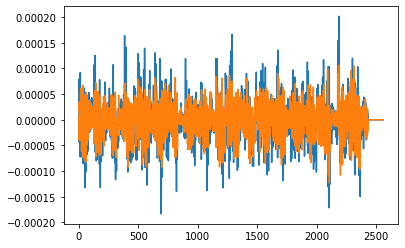

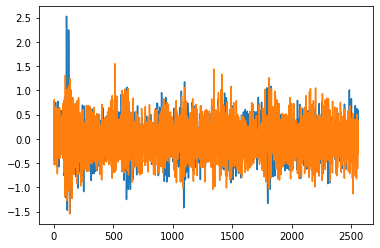

In [17]:
with tf.GradientTape() as tape:
    gg= curr_data[1][0].copy()
    for n in gg.nodes:
        n.node_attr_tensor = tf.Variable(n.node_attr_tensor)
    inp = [n.node_attr_tensor for n in gg.nodes]
    
    out = gn_tot.eval_graphnets(gg, iterations = 10, return_probs_for_all_nodes=False).mean()
    grad = tape.gradient(out,inp)

nnode = 4
pplot.plot(grad[nnode].numpy()[0])
pplot.show()
pplot.plot(inp[nnode].numpy()[0])


In [18]:
#node_to_value
def eval_determ(graphs_in):
    node_val = gn_tot.eval_graphnets(graphs_in, iterations=5, return_final_node=True)
    return determ_model(node_val)

In [19]:
nbatch = 1
curr_data = get_multi_batch_femto(nbatch, source_ds=True,nnodes=5,
                            min_spacing = min_spacing,
                            nseq_range = nseq_range,
                            fixed_spacing_indices=fixed_spacing_indices);

node_times = np.stack(curr_data[0][0].node_times)
node_times


array([[1.6359999],
       [1.486    ],
       [1.356    ],
       [1.346    ],
       [1.326    ]], dtype=float32)

In [20]:
curr_data[0][1]

array([1.326], dtype=float32)

  0%|          | 0/600 [00:00<?, ?it/s]

nnodes: 10, seq_range 200 epoch: 0
loss: 105.871, val_loss 119.458


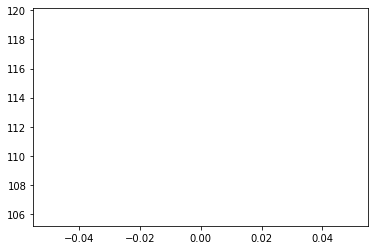

  0%|          | 1/600 [00:05<56:28,  5.66s/it]

nnodes: 10, seq_range 200 epoch: 1


  0%|          | 2/600 [00:09<47:06,  4.73s/it]

loss: 97.900, val_loss 109.885
nnodes: 10, seq_range 200 epoch: 2


  0%|          | 3/600 [00:13<43:41,  4.39s/it]

loss: 96.293, val_loss 108.253
nnodes: 10, seq_range 200 epoch: 3


  1%|          | 4/600 [00:17<42:24,  4.27s/it]

loss: 95.893, val_loss 107.895
nnodes: 10, seq_range 200 epoch: 4


  1%|          | 5/600 [00:21<41:05,  4.14s/it]

loss: 95.780, val_loss 107.699
nnodes: 10, seq_range 200 epoch: 5


  1%|          | 6/600 [00:25<41:14,  4.17s/it]

loss: 95.574, val_loss 107.358
nnodes: 10, seq_range 200 epoch: 6


  1%|          | 7/600 [00:30<41:22,  4.19s/it]

loss: 95.217, val_loss 106.971
nnodes: 10, seq_range 200 epoch: 7


  1%|▏         | 8/600 [00:34<40:47,  4.13s/it]

loss: 95.040, val_loss 106.801
nnodes: 10, seq_range 200 epoch: 8


  2%|▏         | 9/600 [00:38<40:26,  4.11s/it]

loss: 94.826, val_loss 106.534
nnodes: 10, seq_range 200 epoch: 9


  2%|▏         | 10/600 [00:42<39:51,  4.05s/it]

loss: 94.502, val_loss 106.137
nnodes: 10, seq_range 200 epoch: 10
loss: 94.236, val_loss 105.855


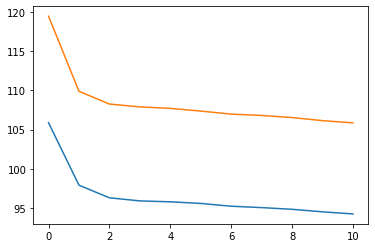

  2%|▏         | 11/600 [00:46<40:05,  4.08s/it]

nnodes: 10, seq_range 200 epoch: 11


  2%|▏         | 12/600 [00:50<39:36,  4.04s/it]

loss: 93.928, val_loss 105.520
nnodes: 10, seq_range 200 epoch: 12


  2%|▏         | 13/600 [00:54<39:18,  4.02s/it]

loss: 93.584, val_loss 105.158
nnodes: 10, seq_range 200 epoch: 13


  2%|▏         | 14/600 [00:58<39:39,  4.06s/it]

loss: 93.341, val_loss 104.928
nnodes: 10, seq_range 200 epoch: 14


  2%|▎         | 15/600 [01:02<39:14,  4.03s/it]

loss: 92.193, val_loss 103.654
nnodes: 10, seq_range 200 epoch: 15


  3%|▎         | 16/600 [01:06<39:13,  4.03s/it]

loss: 93.184, val_loss 104.283
nnodes: 10, seq_range 200 epoch: 16


  3%|▎         | 17/600 [01:10<38:56,  4.01s/it]

loss: 96.771, val_loss 108.356
nnodes: 10, seq_range 200 epoch: 17


  3%|▎         | 18/600 [01:14<38:48,  4.00s/it]

loss: 94.666, val_loss 106.587
nnodes: 10, seq_range 200 epoch: 18


  3%|▎         | 19/600 [01:18<38:52,  4.01s/it]

loss: 93.619, val_loss 105.197
nnodes: 10, seq_range 200 epoch: 19


  3%|▎         | 20/600 [01:22<38:34,  3.99s/it]

loss: 92.100, val_loss 103.590
nnodes: 10, seq_range 200 epoch: 20
loss: 90.634, val_loss 101.452


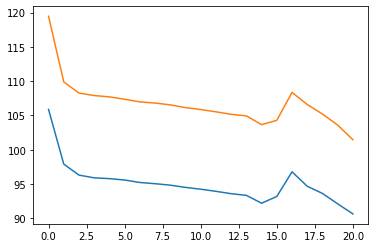

  4%|▎         | 21/600 [01:26<39:05,  4.05s/it]

nnodes: 10, seq_range 200 epoch: 21


In [ ]:
n_epochs = 600
nbatch  = 120#120#120

LOSS_ON_ALL_NODES = True

val_pct = 0.1
fixed_spacing_indices = False;
# nnodes_schedule =     [1,2,5,10] #[10,10,1,2,5]#2,2,3,3]#,1,2,2,1,1,3,3]
# nseq_range_schedule = [100,150,200]#,150];

nnodes_schedule = [10]
nseq_range_schedule = [200]

# nnodes_schedule =     [20] #[10,10,1,2,5]#2,2,3,3]#,1,2,2,1,1,3,3]
# nseq_range_schedule = [200];


min_spacing_schedule =[5];
iterations_schedule = [5]
eval_mode= "batched"
#eval_mode= "safe"

#nnodes_schedule = [1,2,4,4,5,10,5]
#nseq_range_schedule = [2,5,15,15,20,50,30]
#min_spacing_schedule = [1,1,1,1,1,1]
#iterations_schedule =  [3,2,3,3,4]

#nnodes_schedule = [1,2,5]
#nseq_range_schedule = [20]
#min_spacing_schedule = [1,1,1]
#iterations_schedule = [3,3,3]

for i in tqdm(range(n_epochs)):
    np.random.seed(42); 
    epoch = i
    
    # This makes sure that I always get different training and validation sets (there can still be some overlap but training should work ok)
    nnodes      = nnodes_schedule[i%len(nnodes_schedule)]
    nseq_range  = nseq_range_schedule[i%len(nseq_range_schedule)]
    min_spacing = min_spacing_schedule[i%len(min_spacing_schedule)]
    iterations = iterations_schedule[i%len(iterations_schedule)]
    
    if (nnodes * min_spacing) > nseq_range:
        min_spacing = 5
        nseq_range = nnodes * min_spacing+5
        
    print("nnodes: %i, seq_range %i epoch: %i"%(nnodes, nseq_range, i))
    curr_data = get_multi_batch_femto(nbatch, source_ds=True,nnodes=nnodes,
                                min_spacing = min_spacing,
                                nseq_range = nseq_range,
                                fixed_spacing_indices=fixed_spacing_indices);
    
    loss_epoch = 0;
    val_loss_epoch = 0;
    
    for single_minibatch in curr_data:
        with tf.GradientTape() as tape:
            graph_curr, y_curr = single_minibatch;
            node_times = graph_curr.node_times
            #print(graph_curr)
            #def eval_graphnets_loss(graph_curr_, ycurr_,iterations):
            prob_out = gn_tot.eval_graphnets(graph_curr.copy(), iterations, eval_mode=eval_mode, return_probs_for_all_nodes=LOSS_ON_ALL_NODES)
            if not LOSS_ON_ALL_NODES:
                loss_vals = -prob_out.log_prob(y_curr[np.newaxis].T)
            else:
                loss_vals = 0.
                node_times = np.stack(graph_curr.node_times)
                for po, ynode_time in zip(prob_out, node_times):
                    node_loss = -po.log_prob(ynode_time[np.newaxis].T)
                    loss_vals += node_loss
            #ycurr_t = y_curr[np.newaxis].T
            #ycurr_t = tf.Variable(ycurr_t)
            #loss_vals=  eval_graphnets_loss(graph_curr.copy(), ycurr_t, tf.constant(iterations))
            
            all_weights =gn_tot.weights()
            
            
            train_loss = loss_vals[0:int(nbatch*(1-val_pct))];
            
            grads = tape.gradient(train_loss, all_weights)
            all_weights_filt = [all_weights[k] for k in range(len(grads)) if grads[k] is not None]
            grads_filt = [grads[k] for k in range(len(grads)) if grads[k] is not None]
            opt.apply_gradients(zip(grads_filt, all_weights_filt))
            loss_epoch += train_loss/len(y_curr)
        
        val_loss_epoch += tf.reduce_mean(loss_vals[int(-nbatch*(val_pct)):])
        
    loss_log.append_loss(np.sum(loss_epoch.numpy()))
    loss_log.append_val_loss(np.sum(val_loss_epoch.numpy()))
    loss_log.print()
    lr_scheduler.on_epoch_end(epoch)
    if early_stop.on_epoch_end(epoch):
        break
        
    if epoch%10 == 0:
        pplot.plot(loss_log.loss_history['loss'])
        pplot.plot(loss_log.loss_history['val_loss'])
        pplot.show()
        

In [23]:
gn_tot.eval_graphnets(curr_data[1][0].copy(), return_final_node=True)

<tf.Tensor: shape=(120, 32), dtype=float64, numpy=
array([[-1.99863815,  1.99008909,  1.99836483, ...,  0.0163626 ,
        -1.12737731,  1.93869289],
       [-1.71898183,  1.99989251,  1.99571864, ...,  0.02278845,
         1.86523695,  0.16315971],
       [-1.99239486,  1.99796125,  1.99812609, ...,  0.02193659,
         0.78606656,  1.81092538],
       ...,
       [-1.99987596, -1.62264514,  1.9900516 , ...,  0.03363399,
        -1.99968759,  1.99898839],
       [-1.59246035,  1.99990111,  1.99336293, ...,  0.01843405,
         1.92142547, -0.14579321],
       [-1.99986698, -1.69283175,  1.97806046, ...,  0.03962864,
        -1.99978219,  1.99925214]])>


## Improving evaluation and training performance with batching
The initial implementation was not attempting to have multiple edges and nodes evaluated at the same time.
By parallelizing that, for the current architecture (networks with causal connectivity) it was found that even for relatively few vertices there is a two-fold improvement in performance. 

| nodes in graph  | safe | batched |
|----|-----------|--------|
|5  | 4.10s/it |3.5s/it |
|10 | 11.85s/it |5.2s/it |

next step to improve performance is supporting compilation (`@tf.function` decorator) and for improved usability it may be a good idea to implement something like the graph tuple of deepmind's graphnet implementation.

In [24]:

def graphnet_latent_states(graph_data_, iterations = 2):
    graph_out_tmp = gn_tot.graph_indep.graph_eval(graph_data_)
    lat_states = [graph_out_tmp]
    for iterations in range(iterations):
        graph_out_tmp = gn_tot.core.graph_eval(graph_out_tmp) + graph_out_tmp
        lat_states.append(graph_out_tmp)
    return lat_states

# curr_data = get_multi_batch(2, source_ds=True,nnodes=5,
#                             min_spacing = 20,
#                             nseq_range = 100,
#                             fixed_spacing_indices=True);
# c = curr_data[0][0]


# for c in curr_data:
#     c = c[0]
#     c = graphnet_latent_states(c.copy(), iterations =5)
#     pplot.figure(figsize = (10,5)) 
#     pplot.subplot(1,2,1)
#     pplot.pcolor(np.vstack([c_.nodes[-1].node_attr_tensor.numpy() for c_ in c]).T)
#     pplot.subplot(1,2,2)
#     pplot.pcolor(np.vstack([c_.nodes[0].node_attr_tensor.numpy() for c_ in c]).T)
#     pplot.show()
    

Text(0.5, 1.0, 'Loss curves\nBearings dataset')

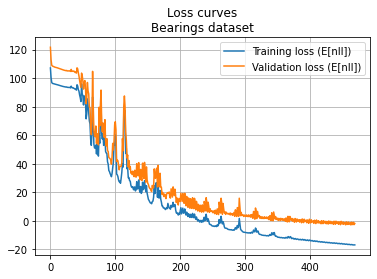

In [25]:
#pplot.figure(dpi - )
pplot.plot(loss_log.loss_history['loss'],label = 'Training loss (E[nll])')
pplot.plot(loss_log.loss_history['val_loss'],label = 'Validation loss (E[nll])')
pplot.legend()
pplot.grid()
pplot.title("Loss curves\nBearings dataset")
#pplot.savefig("/home/charilaos/current/paper/figures/losscurves_bearings.pdf")


Text(0.5, 1.0, 'Loss curves\nBearings dataset')

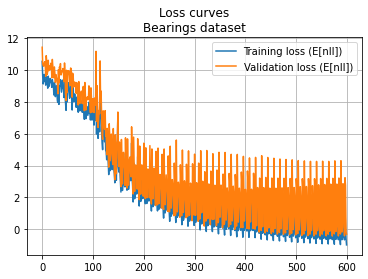

In [90]:
#pplot.figure(dpi - )
pplot.plot(loss_log.loss_history['loss'],label = 'Training loss (E[nll])')
pplot.plot(loss_log.loss_history['val_loss'],label = 'Validation loss (E[nll])')
pplot.legend()
pplot.grid()
pplot.title("Loss curves\nBearings dataset")


10


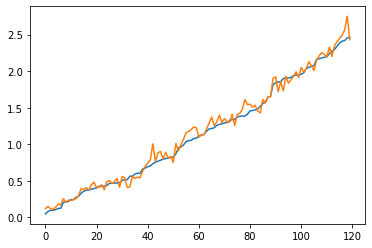

In [26]:
#loss_vals = -prob_out.log_prob(y_curr[np.newaxis].T)
#loss_vals
print(nnodes)
prob_out = gn_tot.eval_graphnets(graph_curr.copy(), iterations, return_probs_for_all_nodes=False)

ids_sort = np.argsort(y_curr);
pplot.plot(y_curr[ids_sort])
pplot.plot(prob_out.mean().numpy().flatten()[ids_sort])

In [27]:
inds_exp_target

[0, 5, 6, 8, 9, 10, 13, 14, 15]

In [28]:
# Inspect the learned embeddings for different experiments. See if some of them cluster.
def get_exp_dat(exp_num, keep_from_end, skip = 5):
    ids = np.argmax(femto_dataset.eid_oh,1) == exp_num
    
    return femto_dataset.X[ids][-keep_from_end::skip,:,:],femto_dataset.yrem_norm[ids][-keep_from_end::skip]
#embs = graph_indep.node_function(get_exp_dat(1))
#graph_indep.node_function.summary()

keep_from_end = 200;
all_embs = []
exp_inds_plot = []
yfrom_ends = []
for ee in [*inds_exp_source, *inds_exp_target]:
    g, gg = get_exp_dat(ee, keep_from_end)
    
    e = gn_tot.graph_indep.node_function([np.zeros([g.shape[0],1]).astype("float32") ,g])
    all_embs.append(e)
    exp_inds_plot.append([ee]*len(g))
    yfrom_ends.append(gg)
    
    
exp_inds_plot = np.hstack(exp_inds_plot)
yfrom_ends = np.hstack(yfrom_ends)
#graph_indep.node_function.inputs

#graph_indep.node_function()


In [29]:
istarget = np.zeros_like(exp_inds_plot)
istarget[[e_ for e_,e in enumerate(exp_inds_plot) if e in inds_exp_target]] = 1


In [30]:
all_embs_ = np.vstack([a.numpy() for a in all_embs])
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
pca = PCA(n_components=4);
tsne = TSNE(n_components=2);
tsne= tsne.fit_transform(all_embs_)
#pplot.scatter(epca[:,0],epca[:,1])


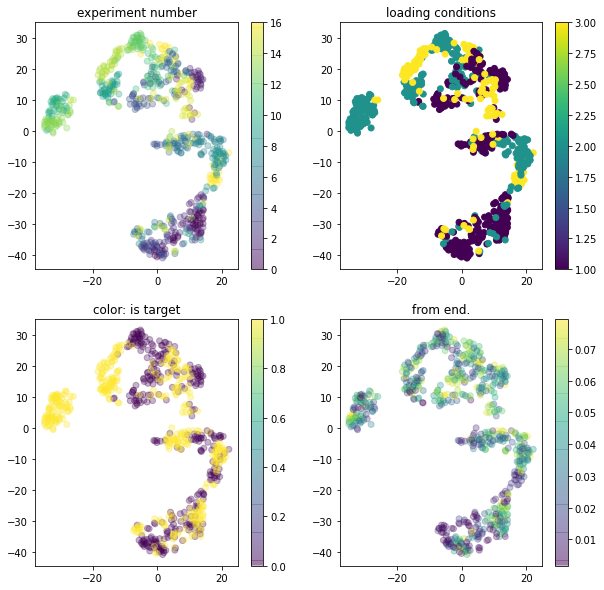

In [31]:
pplot.figure(figsize = (10,10))
pplot.subplot(2,2,1)
pplot.scatter(tsne[:,0], tsne[:,1],c = exp_inds_plot, alpha = 0.3)
pplot.title("experiment number")
pplot.colorbar()
pplot.subplot(2,2,2)
pplot.scatter(tsne[:,0], tsne[:,1],c = [femto_dataset.exp_to_cond_dict[k] for k in exp_inds_plot])
pplot.title("loading conditions")
pplot.colorbar()
pplot.subplot(2,2,3)
pplot.scatter(tsne[:,0], tsne[:,1], c = istarget, alpha = 0.3)
pplot.title("color: is target")
pplot.colorbar()
pplot.subplot(2,2,4)
pplot.scatter(tsne[:,0], tsne[:,1], c = yfrom_ends, alpha = 0.3)
pplot.title("from end.")
pplot.colorbar()
pplot.show()


In [33]:
# for eid in range(0,17):
#     pplot.figure(figsize = (10,5))
#     pplot.subplot(1,2,1)
#     valsx = np.vstack([np.abs(np.fft.fft(ff[:,0])[0:1279])**0.5 for ff in femto_dataset.X[femto_dataset.eid==eid][0:100]]).T
#     valsy = np.vstack([np.abs(np.fft.fft(ff[:,0])[0:1279])**0.5 for ff in femto_dataset.X[femto_dataset.eid==eid][0:100]]).T
#     pplot.pcolor(valsx, cmap='gray')
#     pplot.title("%i spectrogram"%eid)
#     pplot.subplot(1,2,2)
#     pplot.plot(np.mean(valsx,1))
#     pplot.plot(np.mean(valsy,1))
#     pplot.show()

In [34]:
targets =[t for t in inds_exp_target if t not in inds_exp_target]

In [35]:
femto_dataset.inds_exp_target

[0, 5, 6, 8, 9, 10, 13, 14, 15]

# Plot output of conv features:

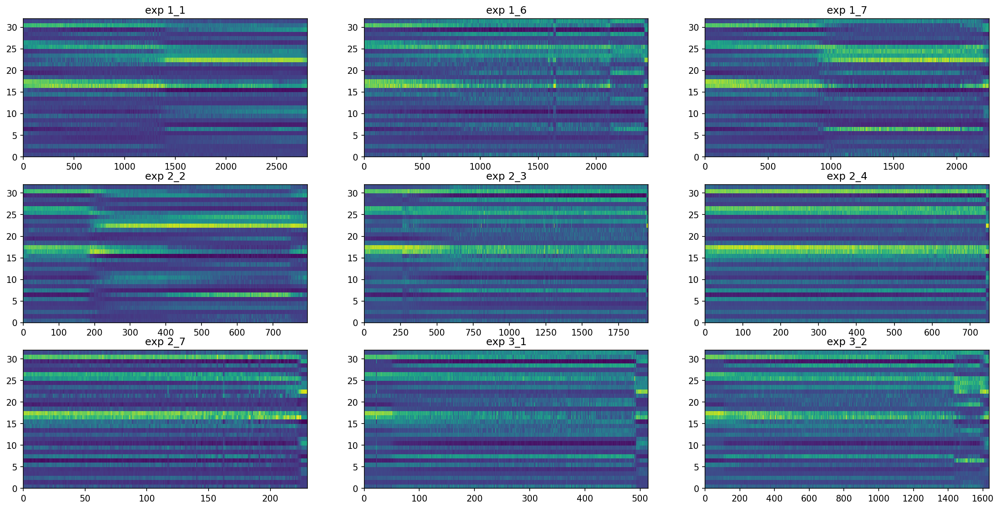

In [36]:
pplot.figure(figsize = (20,10), dpi = 150)
for ii,ee in enumerate(femto_dataset.inds_exp_target):
    Xee = femto_dataset.X[femto_dataset.eid == ee]

    emb = gn_tot.graph_indep.node_function.predict((np.zeros([Xee.shape[0],1])+0.00,Xee), batch_size=100)
    pplot.subplot(3,3,ii+1)
    pplot.pcolor(emb.T)
    pplot.title("exp %s"%(femto_dataset.file_suffix[ee]))


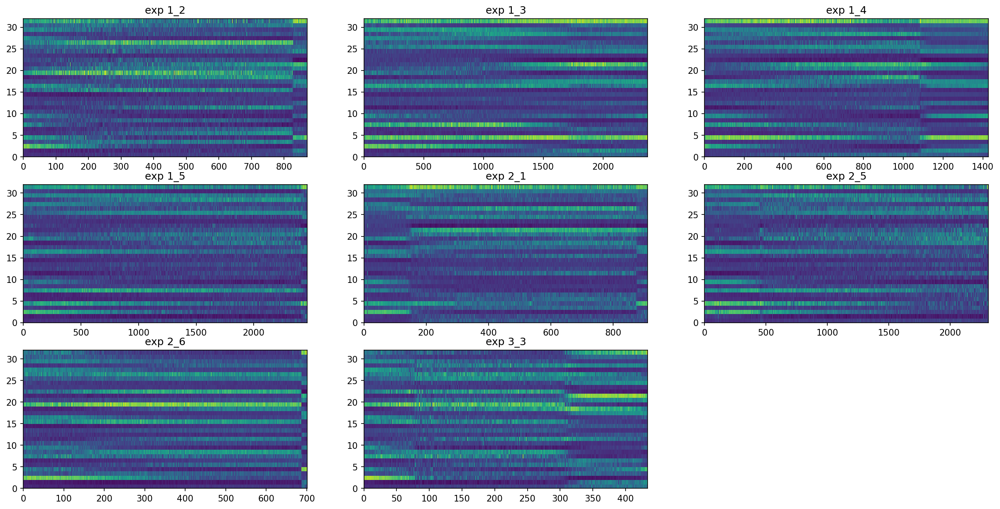

In [93]:
pplot.figure(figsize = (20,10), dpi = 150)
for ii,ee in enumerate(femto_dataset.inds_exp_source[0:10]):
#     ee = femto_dataset.inds_exp_target[3]
    Xee = femto_dataset.X[femto_dataset.eid == ee]

    emb = gn_tot.graph_indep.node_function.predict((np.zeros([Xee.shape[0],1])+0.0,Xee), batch_size=100)
    pplot.subplot(3,3,ii+1)
    pplot.pcolor(emb.T)
    pplot.title("exp %s"%(femto_dataset.file_suffix[ee]))


In [37]:
from ipywidgets import interact, IntSlider, interactive

In [38]:
femto_dataset.eid

array([ 0,  0,  0, ..., 16, 16, 16])

In [39]:
#mm.predict(femto_dataset.X)


In [40]:
%matplotlib qt5

In [42]:
7089
@interact(iisel = IntSlider(min = 0 , max = 10000, step = 200), exper = IntSlider(min = 0, max = 16))
def aaa(iisel, exper ):
#     iisel = 15000
    xx_ = femto_dataset.X[femto_dataset.eid == exper]
    print(xx_.shape)
    xx = xx_[iisel:(iisel+400)]
    xx = xx.reshape([xx.shape[0]*xx.shape[1],2])[np.newaxis,...]
    vv = gn_tot.graph_indep.node_function(([[0.]],xx))


    lind =  [k-2 for k,l in enumerate(gn_tot.graph_indep.node_function.layers) if 'global' in l.name][0]
    lname = gn_tot.graph_indep.node_function.layers[lind].name
    print(lname)
    lin = gn_tot.graph_indep.node_function.inputs
    lout= gn_tot.graph_indep.node_function.get_layer(lname)

    mm = tf.keras.Model(inputs = lin, outputs = lout.output)
    nn = mm(([[0]],xx)).numpy()
    
    
    nns = np.abs(np.max(np.abs(nn[0]),-1))
    nns=  np.stack([nns,nns]).T
    vv = np.linspace(0,xx.shape[1],nns.shape[0])[np.newaxis]
    [X_, Y_] = np.meshgrid(vv, [-30.,30.])
    pplot.cla()
    
    pplot.pcolor(X_,Y_,nns.T, shading ="auto", cmap = "viridis")
    pplot.plot([v_ for v_ in range(0, xx[0].shape[0])],xx[0][:,0],  "C1", alpha = 0.7)


interactive(children=(IntSlider(value=0, description='iisel', max=10000, step=200), IntSlider(value=0, descrip…

In [43]:

%matplotlib qt5

# Inspecting gradients for interpreting model:
## Inspecting the gradients of the last prediction w.r.t. past observations

In [44]:
## Sample 100~200 samples from all experiments. Sort them according to RUL. 
## split in 3 parts the RUL - up to 1/3 RUL, 2/3 of the RUL and 2/3 to 3/3 or RUL. 
## See where attention is paid for each of the RUL blocks.

curr_data = get_multi_batch_femto(10, source_ds=False,nnodes=10,
                            min_spacing = 5,
                            nseq_range = 200,
                            fixed_spacing_indices=False);

## A gradient-based feature attribution method:
Find the gradient of the output w.r.t. the input and see where the gradient is large. The parts of the input which affect the gradient a lot should be more important to the result. 

In [ ]:
%matplotlib inline

nf= femto_dataset.normalization_factor_time

to_hours_wnf = lambda  x:  (x*nf)/3600

for nexp in range(len(curr_data)):
    print(".")
    dat = curr_data[nexp][0]
    yy = curr_data[nexp][1]
    with tf.GradientTape() as tape:
    #     graph_curr, y_curr = single_minibatch;
        graph_curr = dat 

        # replace graph inputs with tensors so I can take gradients of them:
        for n in graph_curr.nodes:
            n.node_attr_tensor = tf.Variable(n.node_attr_tensor)

        inputs = [n.node_attr_tensor for n in graph_curr.nodes]
        prob_out = gn_tot.eval_graphnets(graph_curr.copy(), iterations, eval_mode="batched", return_probs_for_all_nodes = False)
        outputs = prob_out.mean()
        grad = tape.gradient(outputs,inputs)

    gabs = [];
    for kk in grad:
        gabs_ = np.sum(np.sum(np.abs(kk),-1),-1)
        gabs.append(gabs)
    pplot.plot(gabs,'o-')
    pplot.title("act: %2.3f [h] pred: %2.3f[h] "%(to_hours_wnf(yy), to_hours_wnf(outputs)))
    pplot.ylim([0,max(gabs)+2])
    pplot.show()


In [47]:
gn_tot.eval_graphnets(graph_curr.copy(),  iterations, eval_mode="batched", return_probs_for_all_nodes = False)


<tfp.distributions.Gamma 'sequential_distribution_lambda_Gamma' batch_shape=[10, 1] event_shape=[] dtype=float64>

In [48]:
#[ n.node_attr_tensor.dtype for n in graph_curr.nodes]
[e.edge_tensor.dtype for e in graph_curr.edges]

[dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32'),
 dtype('float32')]

In [49]:
csfont = {'fontname':'Times New Roman','fontsize' : 24}

def plot_experiments(experiments_to_plot, eval_mode = "safe", nseq_len = [200,200,200], xaxis_sample = False, nnodes_list = [1,10,30]):
    #training = inds_exp_source
    nsampled = 500

    pplot.figure(figsize = (15,int(10/3*len(experiments_to_plot))), dpi = 300)
#     nnodes_list = [1,10,30]#,3,5]
    if nseq_len is None:
        nseq_len = [300,300,300]
    
    minspacing= [5,5,5]
    gnsteps  = iterations_schedule* 3
    
    normalization_factor_time = femto_dataset.normalization_factor_time
    plt_data = [];
    kk = 0;
    
    for exp_index , ee in enumerate(experiments_to_plot):
        for nnodes, gnsteps_,nseq_,minspacing_ in zip(nnodes_list, gnsteps, nseq_len, minspacing):
            
            #ee = training[0]
            graphs, y_times = get_graph_data(ee, X_ = femto_dataset.X, eid_oh_ = femto_dataset.eid_oh,
                                             yrem_norm_ = femto_dataset.yrem_norm, n_sampled_graphs = nsampled, 
                                             nnodes=nnodes, fixed_spacing_indices=False, min_spacing=minspacing_,
                                             nseq_range=nseq_)
            probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode, return_probs_for_all_nodes=False)
            #eval_graphnets()
            ids_sorted = np.argsort(y_times)
            #time_grid = np.linspace(np.min(y_times),np.max(y_times), 150);
            time_grid = np.linspace(np.min(y_times), 75000./normalization_factor_time, 150)
            
            tohours = lambda x : x / 3600
            
            #time_grid = np.linspace(np.min(y_times),3.5, 150);

            e_y = probs.mean()
            p_y = probs.prob(time_grid).numpy().T

            y_times_sorted = y_times[ids_sorted];
            y_times_sorted_unnorm = y_times_sorted * normalization_factor_time;
            pplot.subplot( len(experiments_to_plot),len(nnodes_list), kk+1)
            q90 = np.quantile(probs.sample(1000).numpy(),[0.05,0.95],0)[:,:,0].T[ids_sorted]
            
            
            
            if xaxis_sample:
                pplot.pcolor([r for r in range(p_y.shape[1])], time_grid*normalization_factor_time, p_y[:,ids_sorted]**0.5, cmap = "gray")
            else:
                pplot.pcolor(tohours(y_times_sorted_unnorm), tohours(time_grid*normalization_factor_time), p_y[:,ids_sorted]**0.5, cmap = "gray")
                pplot.plot(tohours(y_times_sorted_unnorm), tohours(y_times_sorted  *normalization_factor_time), linewidth = 7)
                
            
            #pplot.plot(e_y.numpy()[ids_sorted]*normalization_factor_time,'C1',label = "$E[t_f]$",alpha = 0.5)<3
            pplot.plot(tohours(y_times_sorted_unnorm),tohours(q90*femto_dataset.normalization_factor_time),'C1-.', alpha = 0.4)
            pplot.ylim(0,tohours(75000))
            if nnodes == 1:
                #pplot.ylabel("Experiment %i/%s\nPredicted RUL[h]"%(ee,femto_dataset.file_suffix[ee]), fontsize = 20)
                pplot.ylabel("Experiment %s\nPredicted RUL[h]"%(femto_dataset.file_suffix[ee]), **csfont)
                
            #pplot.xlabel("Actual time to failure [s]")
            
            #pplot.ylabel("Predicted time to failure [s]")
            
            #pplot.xlabel("Predicted RUL[h]",fontsize = 20)

            nll = -np.mean(probs.log_prob(y_times[np.newaxis].T))
            
            parameters = {'nnodes' : nnodes, 'gnsteps' : gnsteps_ ,  'minspacing_' : minspacing}
            density_plot = {'density_plot' : (y_times_sorted_unnorm, time_grid * normalization_factor_time, p_y[:, ids_sorted]**0.5), 
                            'actual_ttf_line' : (y_times_sorted_unnorm, y_times_sorted  *normalization_factor_time), 
                            'eval_parameters' : parameters}
            quantiles = {'quantiles' : (y_times_sorted_unnorm,q90*femto_dataset.normalization_factor_time)}
            loss = {'experiment' : ee, 'nll' : nll}
            plt_data.append({'loss' : loss,'quantiles' : quantiles , 'density_plot' : density_plot, 'parameters'  : parameters})
            
            
            if exp_index == 0:
                title = "Obs.:%i\nNLL:%2.3f"%(nnodes,nll)
            else:
                title = "NLL:%2.3f"%(nll)
                
            if exp_index == (len(experiments_to_plot)-1):
                pplot.xlabel("Actual RUL[h]", **csfont)
                
            pplot.title(title, **csfont)
            kk+=1
            #p_y.shape
            #pplot.show()
    pplot.subplots_adjust(hspace = 0.30, wspace = 0.30)
    #pplot.show()
    return plt_data
    

In [50]:
# non_training

In [51]:
[femto_dataset.file_suffix[ee] for ee in femto_dataset.inds_exp_source]

['1_2', '1_3', '1_4', '1_5', '2_1', '2_5', '2_6', '3_3']

In [52]:
i1 = femto_dataset.file_suffix.index('1_3')
i2 = femto_dataset.file_suffix.index('3_3')
plot_inds = [i1,i2]
plot_inds

[2, 16]

In [53]:
err_vals = {}
for ee in femto_dataset.inds_exp_target:
    nseq_ = 200
    nsampled = 500
    nnodes = 10
    minspacing_ = 5
    gnsteps_ = iterations
    eval_mode = "safe"
    fid = femto_dataset.file_suffix[ee]
    graphs, y_times = get_graph_data(ee, X_ = femto_dataset.X, eid_oh_ = femto_dataset.eid_oh,
                                                 yrem_norm_ = femto_dataset.yrem_norm, n_sampled_graphs = nsampled, 
                                                 nnodes=nnodes, fixed_spacing_indices=False, min_spacing=minspacing_,
                                                 nseq_range=nseq_)

    probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode, return_probs_for_all_nodes=False)
    vv = probs.mode().numpy().flatten()
    nanmask = ~np.isnan(vv)
    vv = vv[nanmask]
    y_times = y_times[nanmask]
    mm= np.mean(tf.keras.losses.mape(y_times, vv ))
    err_vals.update({fid : mm})
    
err_vals

{'1_1': 41.85441580069394,
 '1_6': 38.87900738202374,
 '1_7': 97.02102747153761,
 '2_2': 70.95677102194975,
 '2_3': 169.49254616366707,
 '2_4': 378.7195485366036,
 '2_7': 7580.415805851592,
 '3_1': 239.4726509942547,
 '3_2': 68.35978316507479}

In [54]:
err_vals

{'1_1': 41.85441580069394,
 '1_6': 38.87900738202374,
 '1_7': 97.02102747153761,
 '2_2': 70.95677102194975,
 '2_3': 169.49254616366707,
 '2_4': 378.7195485366036,
 '2_7': 7580.415805851592,
 '3_1': 239.4726509942547,
 '3_2': 68.35978316507479}

<ipython-input-49-8cae64fdde88>:50: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  pplot.pcolor(tohours(y_times_sorted_unnorm), tohours(time_grid*normalization_factor_time), p_y[:,ids_sorted]**0.5, cmap = "gray")
<ipython-input-49-8cae64fdde88>:50: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  pplot.pcolor(tohours(y_times_sorted_unnorm), tohours(time_grid*normalization_factor_time), p_y[:,ids_sorted]**0.5, cmap = "gray")
<ipython-input-49-8cae64fdde88>:50: Ma

[(1, 0, 1.5135885856149416), (5, 0, 2.3249063724503487), (10, 0, 2.184499501183319), (1, 5, 2.792961675523692), (5, 5, 2.3386076776940152), (10, 5, 1.9660459331005817), (1, 8, 1.256172134745503), (5, 8, 1.1851062989608212), (10, 8, 1.4618443471089146)]


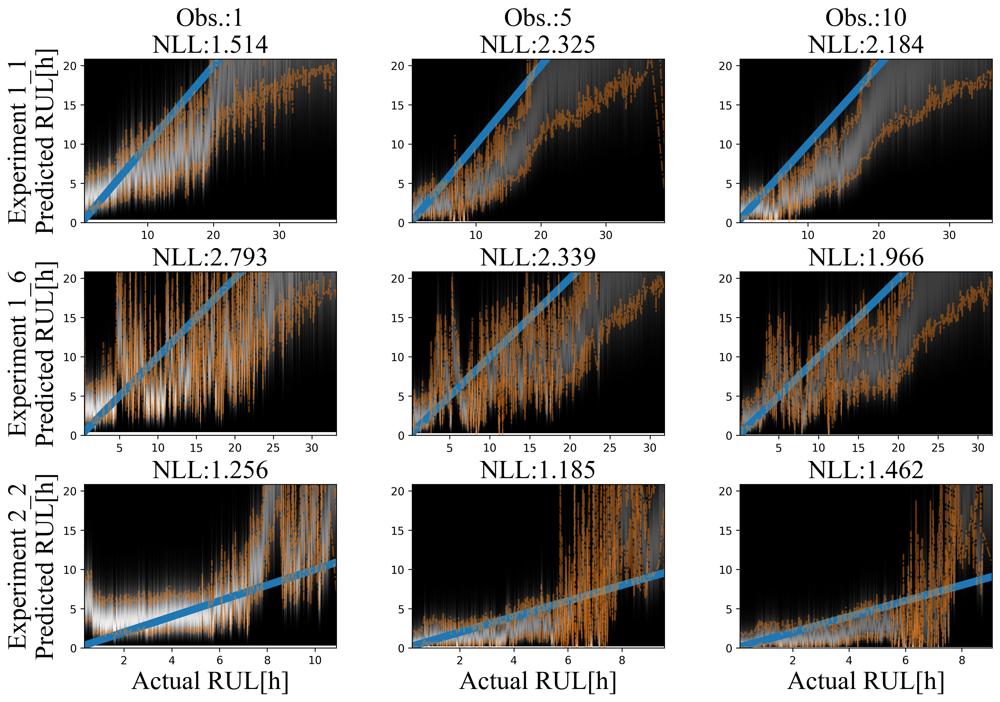

In [55]:
inds_exp_target, inds_exp_source
#ii = []
non_training =[ v_ for v_ in np.unique(femto_dataset.eid) if v_ not in femto_dataset.inds_exp_source]
# bad_results = ['1_4','2_7','2_6', '2_5','2_4','2_3'][0:3]

plt_inds = femto_dataset.inds_exp_target #[femto_dataset.file_suffix.index(bb) for bb in bad_results]
plt_inds = [femto_dataset.file_suffix.index(kk) for kk in ['1_1','1_6','1_7','2_2','3_2']]
plt_inds = [femto_dataset.file_suffix.index(kk) for kk in ['1_1','1_6','2_2']]

nnodes = [1,5,10]
plot_data = plot_experiments(plt_inds,nseq_len=[100,200,200], nnodes_list= nnodes)
print([(p['parameters']['nnodes'],p['loss']['experiment'],p['loss']['nll']) for p in plot_data])
#pplot.savefig("test_set_GNN-tCNN.eps")
pplot.savefig("/tmp/test_set_GNN-tCNN_fsize30_Iter%i.png"%(iterations_schedule[0]))

In [ ]:
!mv /tmp/test_set_GNN-tCNN_fsize30_Iter3.png

## Prediction at speciffic time for test-set experiments
Because the FEMTO dataset had a speciffic evaluation metric and there are works reporting it, I need to return predictions for speciffic time-instants for each experiment:

| exp. | time eval. | time to fail.|
|----|-----|----|
|1_3  | 18010 | 5730|
|1_4  | 11380 | 339(*) |
|1_5  | 23010 | 1610|
|1_6 | 23010 | 1460 |
|1_7 | 15010 | 7570|
|2_3 | 12010 | 7530|
|2_4 | 6110 | 1390|
|2_5 | 20010 | 3090|
|2_6 | 5710 |1290|
|2_7 | 1710| 580|
|3_3 | 3510| 820|

(*) this value seems to be wrong according to the data.


In [145]:
# Exp. id, eval. at, RUL.
experiments_and_times = [('1_3',18010,5730),
('1_4',11380,339),
('1_5',23010,1610),
('1_6',23010,1460),
('1_7',15010,7570),
('2_3',12010,7530),
('2_4',6110,1390),
('2_5',20010,3090),
('2_6',5710,1290),
('2_7',1710,580),
 ('3_3',3510,820)]


In [146]:

def get_indices_fixed_max(nsamples, ntotal_inds, nmax_idx = None, nseq_range = None,
                          nmin_idx_diff = None,npoints_per_seq = None):
    """
    Special sampling - get random indices from the past including the last point.
    """

    sample_indices = [];
    for i in range(nsamples):
        
        s = nmax_idx
        s_ = np.sort(np.random.choice(range(1,nseq_range, nmin_idx_diff), npoints_per_seq-1, replace = False)).astype(int)
        s = s - s_
        s = np.hstack([s, nmax_idx])
        s = np.sort(s)
        sample_indices.append(s)

    return np.vstack(sample_indices)


    
def get_graph_data_at_time(experiment_, time = None, X_ = None, eid_oh_ = None, yrem_norm_ = None, 
                   n_sampled_graphs = 100, nnodes = 3, min_spacing = 20, 
                   nseq_range = 100, node_time_scaling = 1.):
    """ 
    Get data ready for evaluation with a graphnet, together with the values of the quantity of interest (e.g. remaining life of component)
    This function is useful mainly for evaluation, where we want graph samples that correspond to a specific terminal elapsed time.
    If time == None, then the maximum time returned corresponds to the max entry of yrem_norm (data assumed sorted by time).
    """
    
    # For computational efficiency the number of nodes and edges in each graph is the same. 
    # For efficiency in creating the dataset, the nodes and edges are also created in parallel.
    exp_dat = (X_, yrem_norm_) #data_from_experiment(experiment_, X_ = X_, eid_oh_ = eid_oh_, yrem_norm_ = yrem_norm_)
    ntotal_inds = exp_dat[0].shape[0];
    inds = get_indices_fixed_max(n_sampled_graphs, ntotal_inds,nmax_idx=ntotal_inds-1, nseq_range = nseq_range,
                      npoints_per_seq = nnodes, nmin_idx_diff = min_spacing)
    X__, y__ = exp_dat;
    node_attr  = [X__[inds_,...] for inds_ in inds.T];
    node_times = [y__[inds_]*node_time_scaling for inds_ in inds.T]; # to be used for making attributes for the edges.
    nodes= [Node(node_attr_) for node_attr_ in node_attr];
    
    ## Connect all edges with all previous edges:
    edges = []
    for i in range(len(nodes)):
        node_to_idx = i 
    
        if node_to_idx == 0:
            next #first node does not have an incoming node.
    
        for node_from_idx in range(0, node_to_idx):
            y_from, y_to = [node_times[ni] for ni in [node_from_idx, node_to_idx]]
            edge_attr = y_to - y_from
            #print("node_from/to: %i %i"%(node_from_idx, node_to_idx))
            edges.append(Edge(edge_attr[:,np.newaxis], node_from = nodes[node_from_idx], node_to = nodes[node_to_idx]));
    g__ =Graph(nodes,edges)
    g__.node_times = node_times
    g__.inds = inds
    return g__,node_times[-1] #Returns a graph and a prediction for the time at the graph's destination node.


In [147]:

# exp_dat = data_from_experiment(experiment, X_ = X_, eid_oh_ = eid_oh_, yrem_norm_ = yrem_norm_)

In [151]:
def predict_for_experiment_at_time(experiment, time_final,nsampled = 2,nnodes = 30, nseq_ = 200, minspacing_ = 5,
         gnsteps_ = iterations_schedule[0],ee = 0):
    
    exp_filter = femto_dataset.eid == experiment
    
    yrem_raw_filt = femto_dataset.yrem_s_raw[exp_filter]
    yrem_norm_filt = femto_dataset.yrem_norm[exp_filter]

    elapsed_times = np.max(yrem_raw_filt) - yrem_raw_filt
    time_filter = (elapsed_times) < time_final

    X_ = femto_dataset.X[exp_filter][time_filter]
    yrem_norm_filt2 = yrem_norm_filt[time_filter]
    eid_oh_ = femto_dataset.eid_oh[exp_filter][time_filter]
    
    
    graphs, y_times = get_graph_data_at_time(experiment, X_ = X_, eid_oh_ = eid_oh_,
                                     yrem_norm_ = yrem_norm_filt2, n_sampled_graphs = nsampled,
                                     nnodes=nnodes,  min_spacing=minspacing_,
                                     nseq_range=nseq_, node_time_scaling=1.)
    print(y_times)
    probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode)
    return probs, y_times

In [ ]:
stats = []
nf = femto_dataset.normalization_factor_time
print("mean, mode, max_q, min_q, actual, Er")
for e, time, act_time  in experiments_and_times:
    exp_index = femto_dataset.file_suffix.index(e)
    ss = "exp. %i (%s), "%(exp_index, e)
    prob, actual_yrem = predict_for_experiment_at_time(exp_index, time)
    samples = prob.sample(1000).numpy().flatten()
    mean = np.mean(samples)*nf
    mode = np.quantile(samples, 0.5)*nf
    q90up = np.quantile(samples, 0.85)*nf
    q90down = np.quantile(samples,0.5)*nf
    stats.append((mean, mode, q90up, q90down))
    Er = 100 * (actual_yrem[1]*nf - mode) /(actual_yrem[0]*nf)
    print(ss + ("%5.2f  "*7)%(*stats[-1], act_time, actual_yrem[0]*nf, Er))
    pplot.hist(samples*nf,100, density=False)
    pplot.vlines(actual_yrem[0]*nf, 0, 100,'r')
    pplot.show()
    
    #pplot.show()
    

In [53]:
[femto_dataset.file_suffix[ee] for ee in femto_dataset.inds_exp_target]

['1_1', '1_6', '2_2', '2_3', '2_4', '2_7', '3_1', '3_2']

exp. 2 (1_3), 8347.23  6747.83  14859.44  231.38  5730.00  5740.00  95.97  
exp. 3 (1_4), 35021.73  32046.42  52899.88  6453.00  339.00  2900.00  -122.52  
exp. 4 (1_5), 13456.90  12324.45  20704.19  2259.88  1610.00  1620.00  -39.50  
exp. 5 (1_6), 10825.45  9821.76  16691.05  1906.24  1460.00  1470.00  -29.68  
exp. 6 (1_7), 6053.84  4967.67  10279.88  387.01  7570.00  7580.00  94.89  
exp. 9 (2_3), 8553.19  7538.19  13844.42  915.03  7530.00  7540.00  87.86  
exp. 10 (2_4), 29823.55  26421.77  46248.63  4915.62  1390.00  1400.00  -251.12  
exp. 11 (2_5), 14927.28  13828.25  22226.37  3410.23  3090.00  3100.00  -10.01  
exp. 12 (2_6), 10452.93  9335.66  16165.65  1722.73  1290.00  1300.00  -32.52  
exp. 13 (2_7), 19184.69  17949.17  27637.34  5284.56  580.00  590.00  -795.69  
exp. 16 (3_3), 5852.40  4938.07  9926.32  397.43  820.00  830.00  52.12  

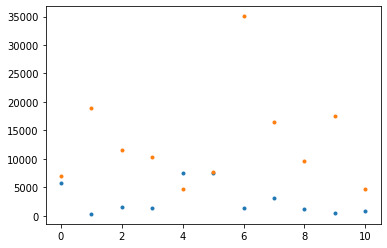

In [447]:
pplot.plot([(e[-1],s[-1])  for e,s in zip(experiments_and_times, stats)],'.')

In [362]:
[ss[0]*femto_dataset.normalization_factor_time for ss in stats]

[15215.85246869912,
 42265.510629008226,
 19291.77381566153,
 15826.473498803793,
 13916.792432477554,
 10038.343329627858,
 38445.38957508627,
 21131.9835172048,
 16114.954001187964,
 27690.156272943183,
 4010.038869172578]

In [312]:
res = predict_for_experiment_at_time(0, )
pplot.hist(res.sample(1000).numpy().flatten()*femto_dataset.normalization_factor_time)

[[-35 -15   5  25  35  45  55  65  85  96]]
97


(array([ 21., 107., 228., 256., 201., 100.,  59.,  19.,   6.,   3.]),
 array([12730.41821391, 21217.82498558, 29705.23175726, 38192.63852893,
        46680.0453006 , 55167.45207228, 63654.85884395, 72142.26561563,
        80629.6723873 , 89117.07915898, 97604.48593065]),
 <BarContainer object of 10 artists>)

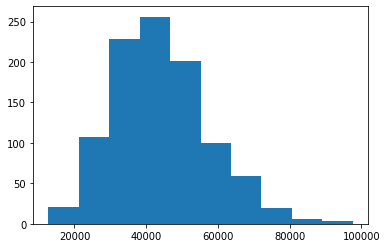

In [300]:
res

In [ ]:
np.sort(np.max(yrem_raw_filt) - y_times * femto_dataset.normalization_factor_time)

In [195]:
# np.max(yrem_raw_filt) ,y_times * femto_dataset.normalization_factor_time

# yrem_norm_ * femto_dataset.normalization_factor_time, list(yrem_raw_filt)

In [148]:

#np.min(y_times)*femto_dataset.normalization_factor_time
#pplot.plot(elapsed_times)
#y_times * femto_dataset.normalization_factor_time
yrem_raw_filt - np.max(yrem_raw_filt)

array([   -52.203125,    -62.203125,    -72.203125, ..., -28052.203   ,
       -28062.203   , -28072.203   ], dtype=float32)

In [41]:
!cp test_set_GNN-tCNN.png /home/charilaos/current/paper/figures/

In [254]:
from matplotlib.font_manager import _rebuild
_rebuild()
import importlib
importlib.reload(pplot)





<module 'matplotlib.pyplot' from '/home/charilaos/.local/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [256]:
pplot.style.available
#pplot.plot(np.random.randn(10))

['seaborn-poster',
 'bmh',
 'seaborn',
 'classic',
 'seaborn-bright',
 'tableau-colorblind10',
 'grayscale',
 'seaborn-muted',
 'seaborn-ticks',
 'ggplot',
 'Solarize_Light2',
 'seaborn-talk',
 'fivethirtyeight',
 'seaborn-deep',
 'seaborn-paper',
 'seaborn-darkgrid',
 'seaborn-pastel',
 'seaborn-colorblind',
 'seaborn-whitegrid',
 'seaborn-notebook',
 'fast',
 'seaborn-white',
 'seaborn-dark',
 '_classic_test',
 'seaborn-dark-palette',
 'dark_background']

In [248]:
matplotlib.matplotlib_fname()

'/home/charilaos/.local/lib/python3.6/site-packages/matplotlib/mpl-data/matplotlibrc'

In [252]:

# def plot_experiments(experiments_to_plot, eval_mode = "safe", nseq_len = None):
#     #training = inds_exp_source
#     nsampled = 500

#     pplot.figure(figsize = (15,10), dpi = 600)
#     nnodes_list = [1,5,10]#,3,5]
#     if nseq_len is None:
#         nseq_len = [200,200,200]
    
#     minspacing= [10,10,10]
#     gnsteps  = [ 5,5,5]
    
#     normalization_factor_time = femto_dataset.normalization_factor_time
#     kk = 0;
#     for ee in experiments_to_plot:
#         for nnodes, gnsteps_,nseq_,minspacing_ in zip(nnodes_list, gnsteps, nseq_len, minspacing):
                
#             #ee = training[0]
#             graphs, y_times = get_graph_data(ee, X_ = femto_dataset.X, eid_oh_ = femto_dataset.eid_oh,
#                                              yrem_norm_ = femto_dataset.yrem_norm, n_sampled_graphs = nsampled, 
#                                              nnodes=nnodes, fixed_spacing_indices=False, min_spacing=minspacing_,
#                                              nseq_range=nseq_)
#             probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode)
#             #eval_graphnets()
#             ids_sorted = np.argsort(y_times)
#             time_grid = np.linspace(np.min(y_times),np.max(y_times), 150);
#             time_grid = np.linspace(np.min(y_times), 60000./normalization_factor_time, 150)
#             #time_grid = np.linspace(np.min(y_times),3.5, 150);

#             e_y = probs.mean()
#             p_y = probs.prob(time_grid).numpy().T

#             y_times_sorted = y_times[ids_sorted];
#             pplot.subplot( len(experiments_to_plot),len(nnodes_list), kk+1)
#             pplot.pcolor([r for r in range(p_y.shape[1])], time_grid*normalization_factor_time, p_y[:,ids_sorted]**0.5, cmap = "gray")
#             pplot.plot(y_times_sorted  *normalization_factor_time)
#             q90 = np.quantile(probs.sample(1000).numpy(),[0.05,0.95],0)[:,:,0].T[ids_sorted]

#             #pplot.plot(e_y.numpy()[ids_sorted]*normalization_factor_time,'C1',label = "$E[t_f]$",alpha = 0.5)<3
#             pplot.plot(q90*femto_dataset.normalization_factor_time,'C1-.', alpha = 0.4)
#             pplot.ylim(0,75000)
#             pplot.xlabel("Sample")
#             pplot.ylabel("Time to failure [s]")

#             nll = -np.mean(probs.log_prob(y_times[np.newaxis].T))

#             title = "Experiment %i (%s)\n Observations:%i \nnll:%2.3f"%(ee,,femto_dataset.file_suffix[ee],nnodes,nll)
#             pplot.title(title)
#             kk+=1
#             #p_y.shape
#             #pplot.show()
#     pplot.subplots_adjust(hspace = 0.65, wspace = 0.5)
#     pplot.show()
    

In [253]:
#unseen =  inds_exp_source[3:6]#[4:7]#inds_exp_source[0:3] #inds_exp_target[0:3]
# unseen = targets[0:3]#[0:1]#inds_exp_source[0:3] #inds_exp_target[0:3]
# print("target")
# plot_experiments(inds_target[0:3])
#plot_experiments([5])
#plot_experiments([15])
#pplot.savefig("graphnet_result_testset.png")
# print("source:")
#plot_experiments(inds_exp_source[0:4])
#pplot.savefig("graphnet_result_trainset.png")

In [176]:
# all_files = femto_dataset.all_files
# counts_dict = femto_dataset.counts_dict
# exp_to_cond_dict = femto_dataset.exp_to_cond_dict
# print("training set:")
# for k,m in [(i,exp_to_cond_dict[i]) for i in inds_exp_source]:
#     print("%02i %i %s %i"%(k,m, all_files[k][5:8],counts_dict[k]))
    
# print("\ntesting set:")
# for k,m in [(i,exp_to_cond_dict[i]) for i in non_training]:
#     print("%02i %i %s %i"%(k,m, all_files[k][5:8],counts_dict[k]))
    
#plot_experiments([10])


In [177]:
# n = Node()
# Graph(n,e)

In [178]:
femto_dataset.inds_exp_source

[1, 2, 3, 4, 7, 11, 12, 16, 6]

In [179]:
femto_dataset.inds_exp_source, non_training

([1, 2, 3, 4, 7, 11, 12, 16, 6], [0, 5, 8, 9, 10, 13, 14, 15])

In [180]:
non_training

[0, 5, 8, 9, 10, 13, 14, 15]

Text(0.5, 1.0, 'rem=90.000')

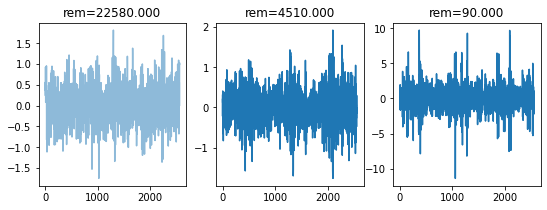

In [101]:
eid = 6;
Xv = femto_dataset.X[femto_dataset.eid == eid]
yrem = femto_dataset.yrem_s_raw[femto_dataset.eid == eid]
sc = 1.5

i1,i2,i3 = [0,int(4*len(Xv)/5),-10]
pplot.figure(figsize = tuple(np.array([6,2])*sc))

pplot.subplot(1,3,1)
pplot.plot(Xv[i1,:,0], alpha = 0.5)
pplot.title("rem=%2.3f"%(yrem[i1]))

pplot.subplot(1,3,2)
pplot.plot(Xv[i2,:,0])
pplot.title("rem=%2.3f"%(yrem[i2]))

pplot.subplot(1,3,3)
pplot.plot(Xv[i3,:,0])
pplot.title("rem=%2.3f"%(yrem[i3]))

In [102]:

#plot_data[0].keys()


In [103]:
plot_data

NameError: name 'plot_data' is not defined

In [104]:
suff = 'b50'
#plot_experiments(targets[0:2])
plot_data = plot_experiments(non_training[0:3],nseq_len=[100,150,200])
pplot.savefig("/tmp/TestSet_Exp_1_%s.png"%suff)
#pplot.savefig("TestSet_Exp_1_b.pdf")

plot_experiments(non_training[3:6],nseq_len=[100,150,200])
pplot.savefig("/tmp/TestSet_Exp_2_%s.png"%suff)
#pplot.savefig("TestSet_Exp_2_b.pdf")

plot_experiments(non_training[6:9],nseq_len=[100,150,200])
pplot.savefig("/tmp/TestSet_Exp_3_%s.png"%suff)
#pplot.savefig("TestSet_Exp_3_b.pdf")

plot_experiments(non_training[9:],nseq_len=[100,150,200])



NameError: name 'non_training' is not defined

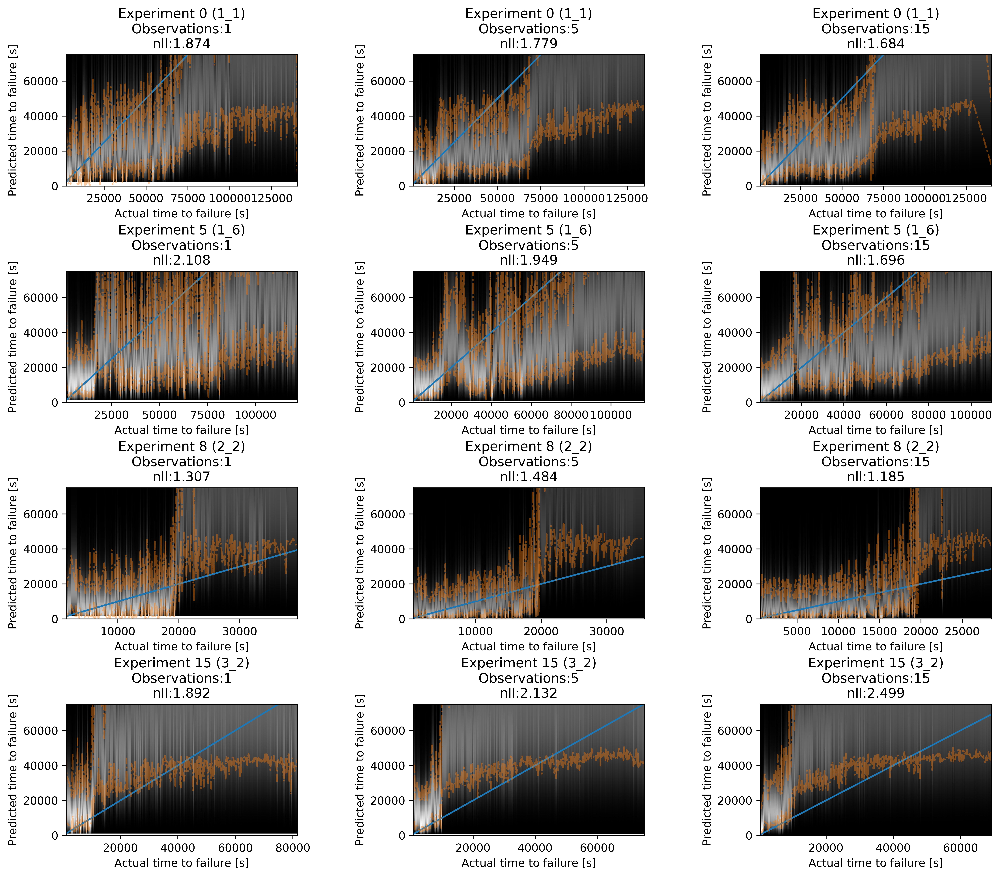

In [63]:
tt = [non_training[k_] for k_ in [0,1,3,8]]
plot_experiments(tt, nseq_len=[100,150,250])
pplot.savefig("test_set_examples_2.png")

Help on method bootstrap_eval_graphnets in module graphnet_utils:

bootstrap_eval_graphnets(graph_data_, iterations=5, n_bootstrap_samples=1, n_nodes_keep=5, eval_mode='batched', return_final_node=False, node_index_to_use=-1) method of graphnet_utils.GraphNetFunctionFactory instance
    Evaluate multiple random samples of nodes from the past. 
    The signature is alsmost the same as `eval_graphnets` with the difference of the parameters n_boostrap_samples (how many times to resample the past nodes) and n_nodes_keep 
    (how many nodes from the past to keep). The last node is always in the computed sample.



In [105]:
for m in range(len(inds_exp_source)):
    x_ = X[np.argmax(eid_oh,axis=-1) == inds_exp_source[m]]
    v = graph_indep.node_function.predict([np.zeros([x_.shape[0],1]),x_], batch_size = 100)
    pplot.plot(v[:,3], label = m)
pplot.legend()

NameError: name 'X' is not defined

In [48]:
plot_experiments(inds_exp_target)
#plot_experiments(inds_exp_target[2:])


NameError: name 'plot_experiments' is not defined

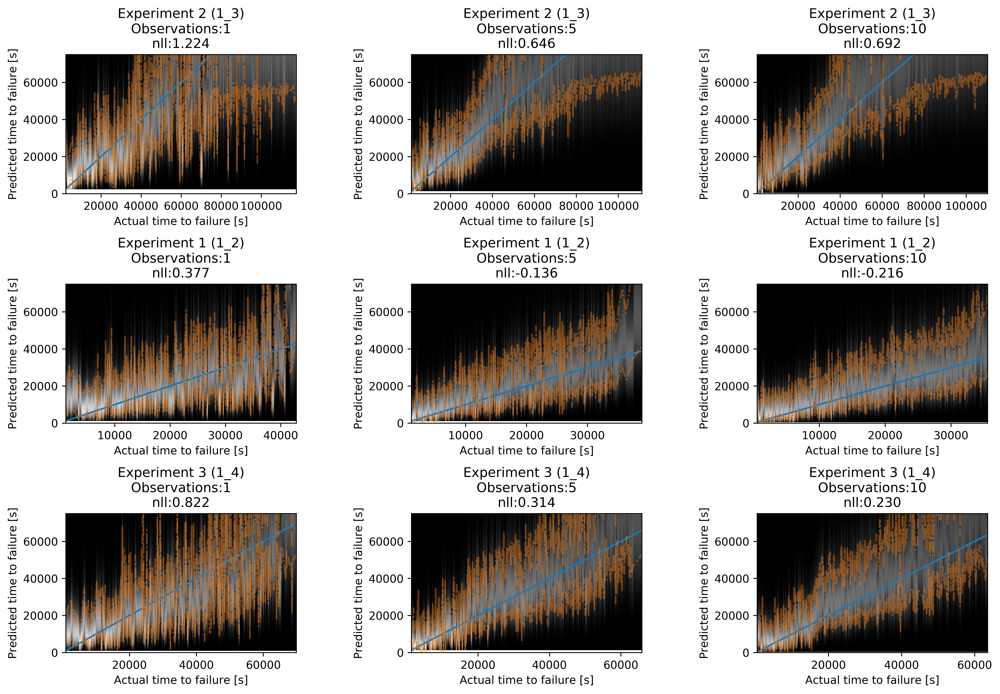

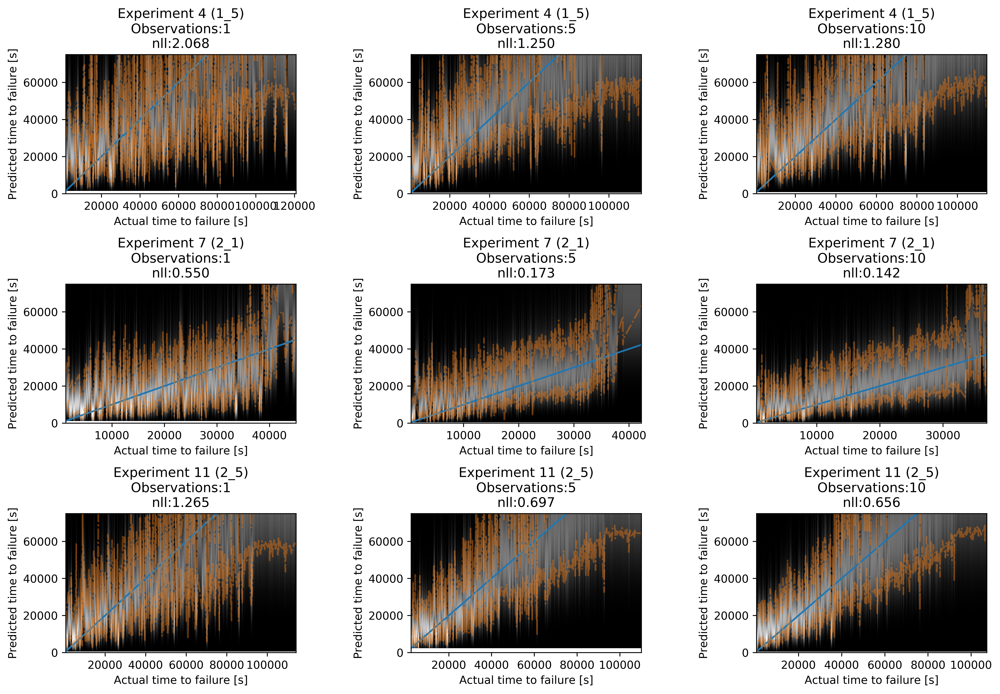

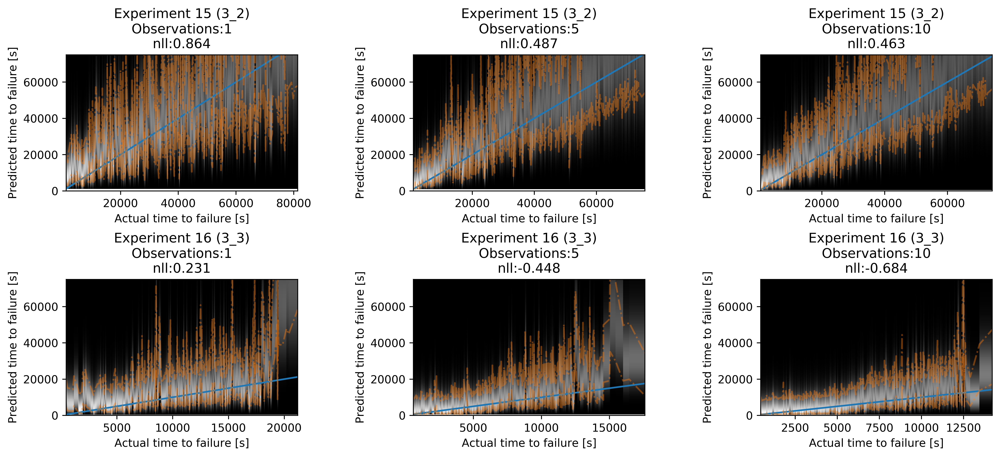

In [184]:

plot_experiments(inds_exp_source[0:3])
plot_experiments(inds_exp_source[3:6])
plot_experiments(inds_exp_source[6:])

#plot_experiments(inds_exp_source[6:])



# Results on unseen data:

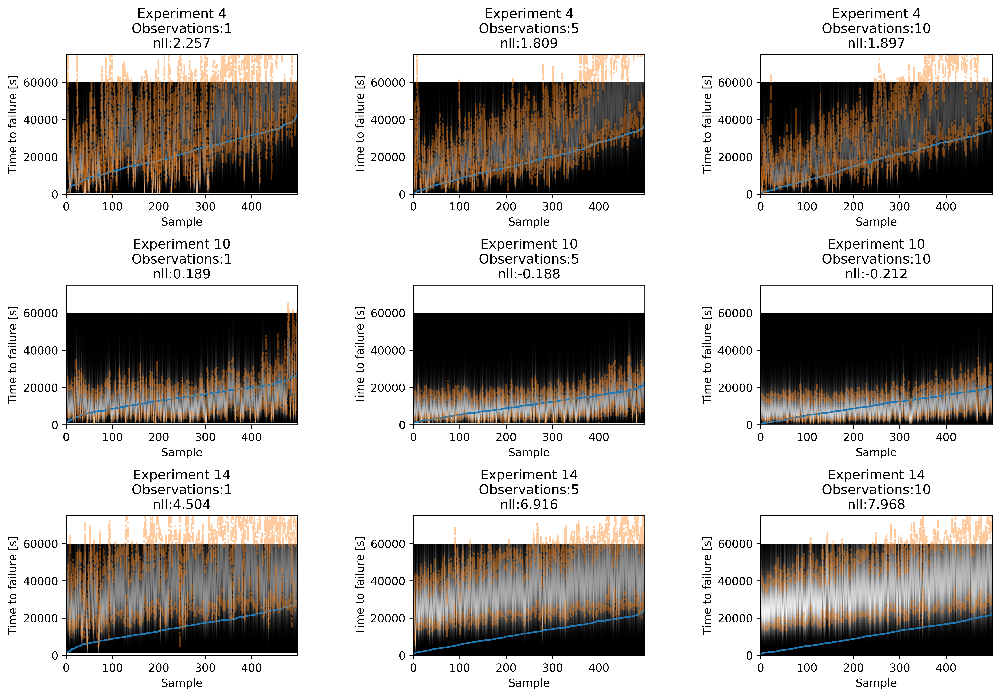

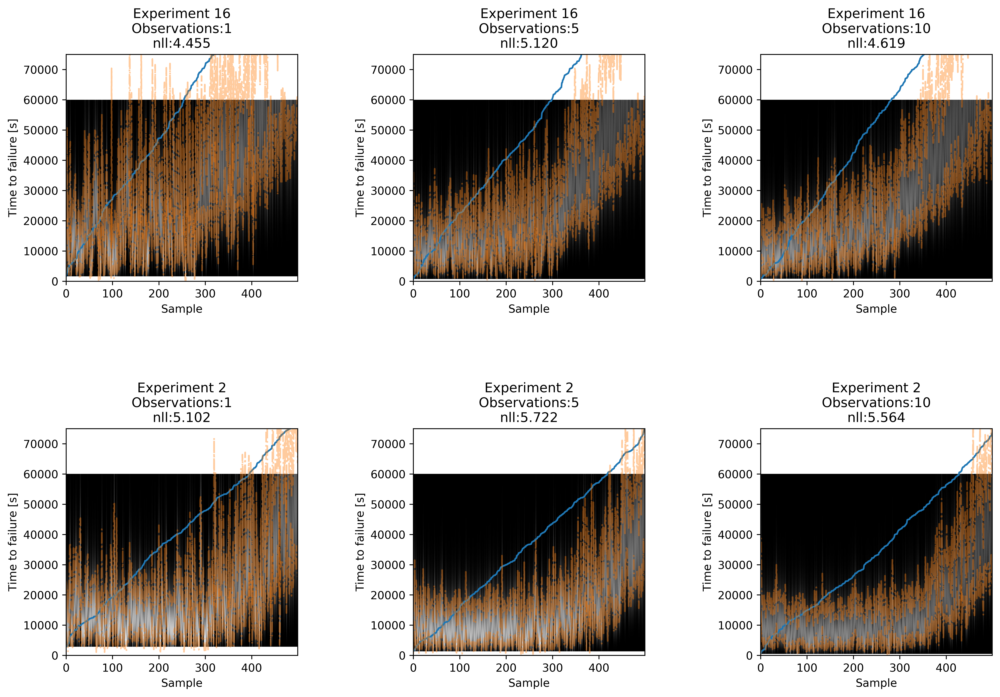

In [98]:

#plot_experiments(inds_exp_target[0:3])
plot_experiments([4,10,14])
plot_experiments(femto_dataset.inds_exp_target)


In [52]:
femto_dataset.inds_exp_source

[5, 6, 7, 8, 13, 15, 3, 12]

In [100]:

inds_exp_target

[16, 2, 8]

In [83]:
femto_dataset.inds_exp_source

[0, 2, 3, 7, 8, 11, 14]

In [183]:
v_ = [inds_exp_source[k] for k in [0,1,2,3,4,5]] 
v1= [femto_dataset.exp_to_cond_dict[v__] for v__ in v_]
print(v_,v1)


[1, 5, 6, 7, 9, 13] [0, 0, 0, 1, 1, 1]


In [ ]:
XX = femto_dataset.X[femto_dataset.eid == inds_exp_source[2]]
XX2 = femto_dataset.X[femto_dataset.eid == inds_exp_source[5]]
pplot.plot(np.hstack(XX[:,:,0]))
pplot.show()
t1 = gn_tot.graph_indep.node_function([np.random.randn(1,1),XX[0::10,:,:]])
t2 = gn_tot.graph_indep.node_function([np.random.randn(1,1),XX2[0::10,:,:]])
#XX.shape

#gn_tot.graph_indep.node_function.summary()